In [1]:
%matplotlib inline
import glob
import os
import numpy as np
import scipy.io as sio
import time
import pickle
import h5py
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import random

In [2]:
TYNAMO_HOME_DIR = '/nfs/tynamo/home/data/vision7/gdhody/chrono/'
BLITZLE_HOME_DIR = '/nfs/blitzle/home/data/vision5/gdhody/chrono/'
HOME_DIR = TYNAMO_HOME_DIR
HDF5_PATH = os.path.join(HOME_DIR, 'storage.hdf5')
PICKLE_PATH = os.path.join(HOME_DIR, 'storage.pkl')

In [3]:
TRAIN_DATA_CHRONO_FILE = os.path.join(HOME_DIR, 'train_samples.pickle')
LABEL_FILE = os.path.join(HOME_DIR, 'UCF_HMDB_ACT.mat')
TRAIN_DATA = sio.loadmat(LABEL_FILE)

<b>Check if all samples/lables are present</b><br>
ACT dataset is provided as serial numbers but the downloaded dataset has class-wise videos listed

In [121]:
TRAIN_UCF = []
TRAIN_HMDB = []
for index, sample in enumerate(TRAIN_DATA['filename']):
    image_file_name = sample[0][0]
    if 'UCF101' in image_file_name:
        image_path = os.path.join(HOME_DIR, image_file_name)
        if len(glob.glob(image_path)):
            frames, crop = TRAIN_DATA['frame'][index], TRAIN_DATA['crop'][index]
            TRAIN_UCF.append((image_file_name, np.array(list(crop)), np.array(list(frames))))
    if 'HMDB51' in image_file_name:
        image_path = os.path.join(HOME_DIR, image_file_name)
        if len(glob.glob(image_path)):
            frames, crop = TRAIN_DATA['frame'][index], TRAIN_DATA['crop'][index]
            TRAIN_HMDB.append((image_file_name, np.array(list(crop)), np.array(list(frames))))

In [19]:
# with open(TRAIN_DATA_CHRONO_FILE, 'wb') as handle:
#     pickle.dump(TRAIN, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [70]:
DISPLAY_IMAGES = 10
display_samples = [int(value) for value in np.random.random((DISPLAY_IMAGES,)) * len(TRAIN)]

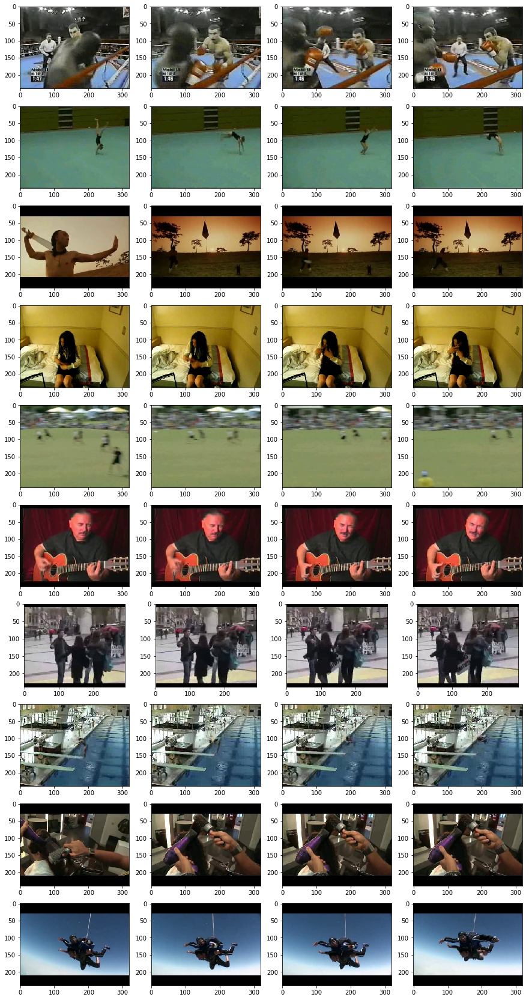

In [16]:
IMAGES = []
NO_FRAMES = 4
for sample in display_samples:
    im_file_name, crop, frames = TRAIN[sample]
    im_file_paths = [os.path.join(HOME_DIR, im_file_name, 'Image' + str(frame) + '.jpg') for frame in frames]
    images = [cv2.imread(im_file_path) for im_file_path in im_file_paths]
    images = [cv2.cvtColor(image, cv2.COLOR_BGR2RGB) for image in images]
    IMAGES.append(images)
plt.subplots_adjust(wspace=1, hspace=1)
plt.subplots(figsize=(15, 30))
index = 1
for frames in IMAGES:
    for frame in frames:
        suub_plt = plt.subplot(DISPLAY_IMAGES, NO_FRAMES, index)
        plt.imshow(frame, interpolation='nearest', aspect='equal')
        index += 1
plt.show()

<b>Display 5 images from each class</b>

In [52]:
UCF_CLASS = {}
UCF_IMAGE = {}
with open('UCF_classes.txt', 'r') as f:
    for line in f:
        class_name = line.split(' ')[-1].replace('\n','')
        UCF_CLASS[class_name.lower()] = 5
        UCF_IMAGE[class_name.lower()] = []

In [53]:
random.shuffle(TRAIN)
NO_FRAMES = 4
for sample in TRAIN:
    image_class = sample[0].split('/')[-1].split('_')[1].lower()
    if image_class in UCF_CLASS.keys() and UCF_CLASS[image_class]:
        im_file_name, crop, frames = sample
        im_file_paths = [os.path.join(HOME_DIR, im_file_name, 'Image' + str(frame) + '.jpg') for frame in frames]
        images = [cv2.imread(im_file_path) for im_file_path in im_file_paths]
        images = [cv2.cvtColor(image, cv2.COLOR_BGR2RGB) for image in images]
        UCF_IMAGE[image_class].append(images)
        UCF_CLASS[image_class] -= 1

In [71]:
# for index_cat,UCF_cat in enumerate(UCF_IMAGE):
#     print UCF_cat.upper(), index_cat
#     plt.figure()
#     plt.subplots_adjust(wspace=1, hspace=1)
#     plt.subplots(figsize=(15, 20))
#     index = 1
#     for frames in UCF_IMAGE[UCF_cat]:
#         for frame in frames:
#             suub_plt = plt.subplot(5, 4, index)
#             plt.imshow(frame, interpolation='nearest', aspect='equal')
#             index += 1
#     plt.show()

In [122]:
REMOVE_CLASSES = [
    'MILITARYPARADE',
    'HAIRCUT',
    'TAICHI',
    'YOYO',
    'APPLYEYEMAKEUP',
    'BABYCRAWLING',
    'PLAYINGTABLA',
    'WRITINGONBOARD',
    'ROCKCLIMBINGINDOOR',
    'BANDMARCHING',
    'DRUMMING',
    'PLAYINGDAF',
    'BLOWINGCANDLES',
    'PLAYINGDHOL',
    'MOPPINGFLOOR',
    'PLAYINGPIANO',
    'TYPING',
    'SKIJET',
    'HEADMASSAGE',
    'PLAYINGSITAR',
    'HORSERACE',
    'SKYDIVING',
    'PLAYINGFLUTE',
    'APPLYLIPSTICK',
    'BRUSHINGTEETH',
    'SURFING',
    'JUGGLINGBALLS',
    'PLAYINGGUITAR',
    'SHAVINGBEARD',
    'BILLIARDS',
    'KNITTING',
    'FENCING',
    'BOXINGSPEEDBAG',
    'MIXING',
    'BLOWDRYER',
    'SALSASPIN',
    'CUTTINGINKITCHEN',
    'RAFTING',
    'HORSERACE',
]

In [123]:
POTENTIAL_REMOVE_CLASSES = [
'BOXINGSPEEDBAG',
'MIXING',
'BOWLING',
'BLOWDRYER',
'SALSASPIN',
'CUTTINGINKITCHEN',
'RAFTING',
'HORSERACE',
'PIZZATOSSING',
'FENCING',
'BILLIARDS',
'SHAVINGBEARD',
'PLAYINGGUITAR',
'BREASTSTROKE',
'KNITTING',
'SURFING',
'JUGGLINGBALLS',
'BILLIARDS',
]

In [75]:
UCF_CLASS = {}
UCF_IMAGE = {}
with open('UCF_classes.txt', 'r') as f:
    for line in f:
        class_name = line.split(' ')[-1].replace('\n','')
        UCF_CLASS[class_name.lower()] = 8
        UCF_IMAGE[class_name.lower()] = []

In [76]:
random.shuffle(TRAIN)
NO_FRAMES = 4
for sample in TRAIN:
    image_class = sample[0].split('/')[-1].split('_')[1].lower()
    if image_class in UCF_CLASS.keys() and UCF_CLASS[image_class]:
        im_file_name, crop, frames = sample
        im_file_paths = [os.path.join(HOME_DIR, im_file_name, 'Image' + str(frame) + '.jpg') for frame in frames]
        images = [cv2.imread(im_file_path) for im_file_path in im_file_paths]
        images = [cv2.cvtColor(image, cv2.COLOR_BGR2RGB) for image in images]
        UCF_IMAGE[image_class].append(images)
        UCF_CLASS[image_class] -= 1

BOXINGSPEEDBAG 11


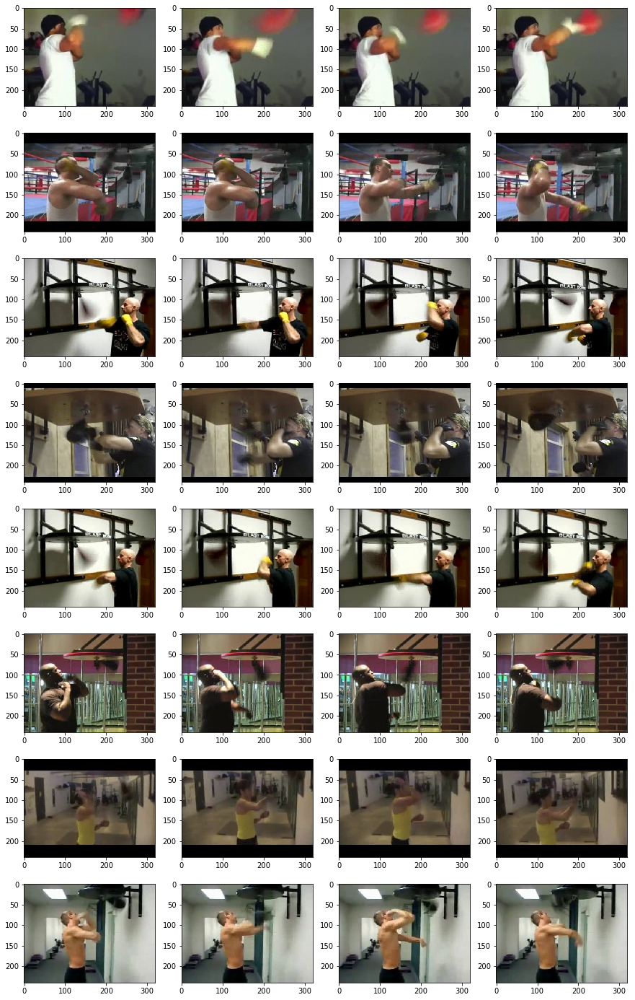

MIXING 15


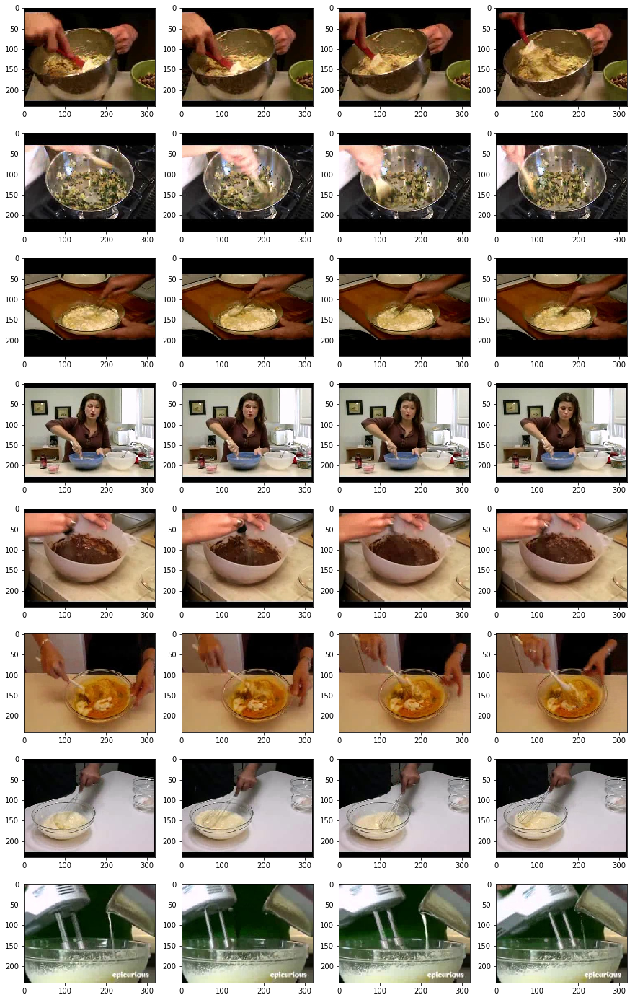

BOWLING 20


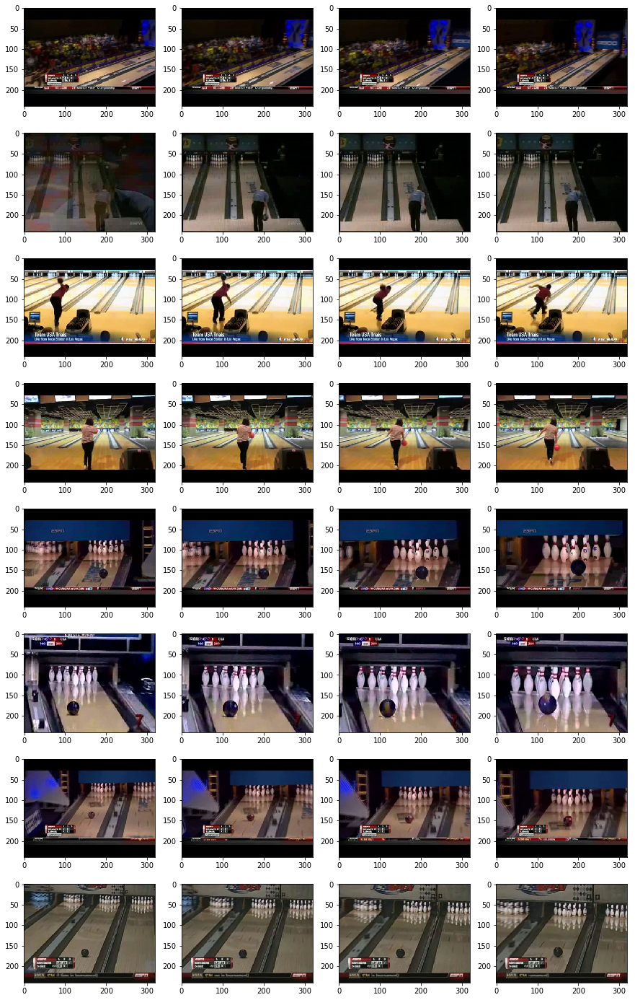

SALSASPIN 29


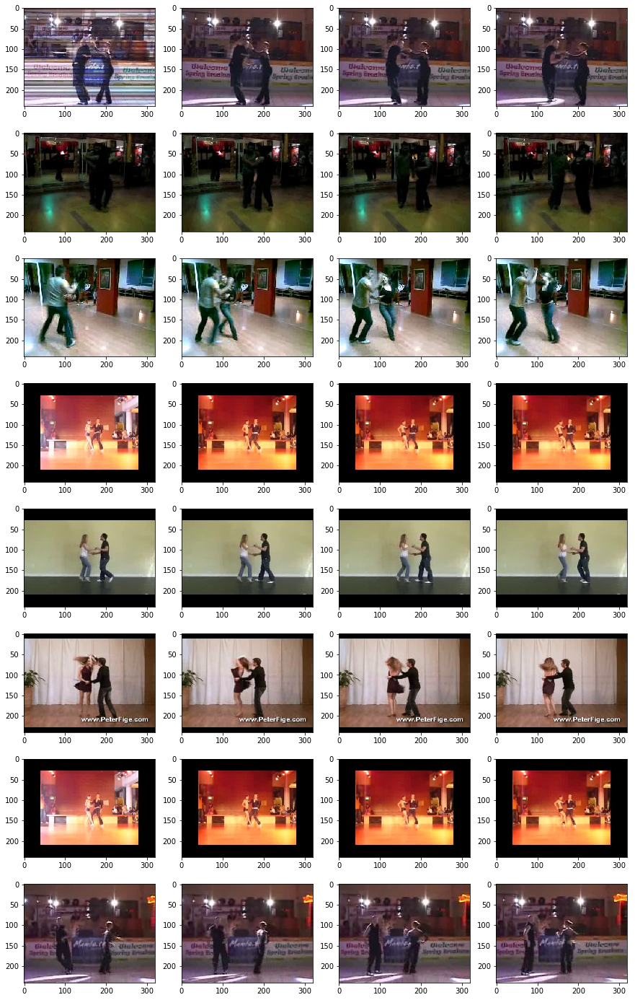

CUTTINGINKITCHEN 36


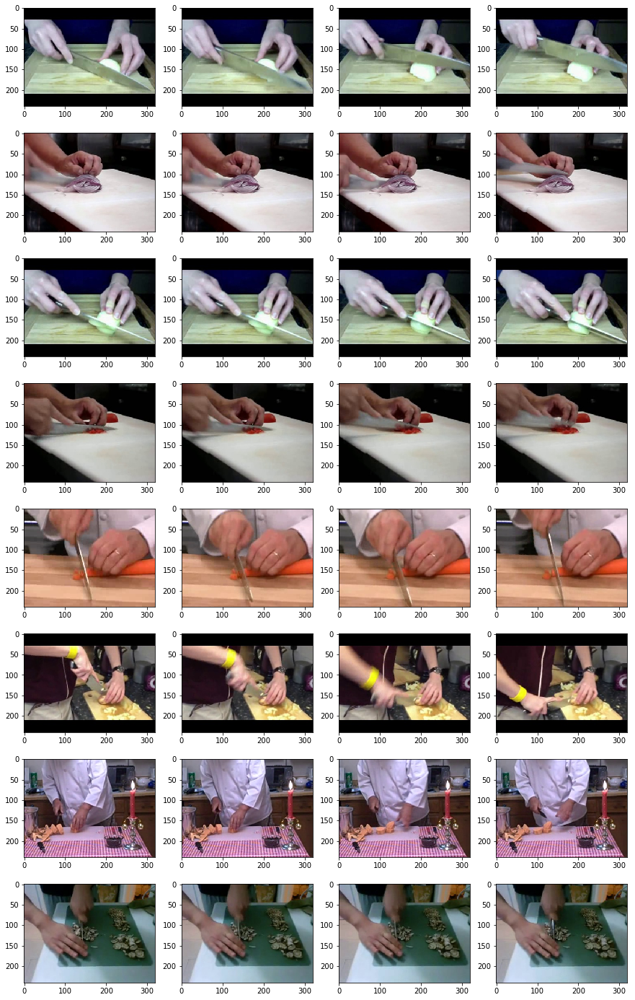

RAFTING 49


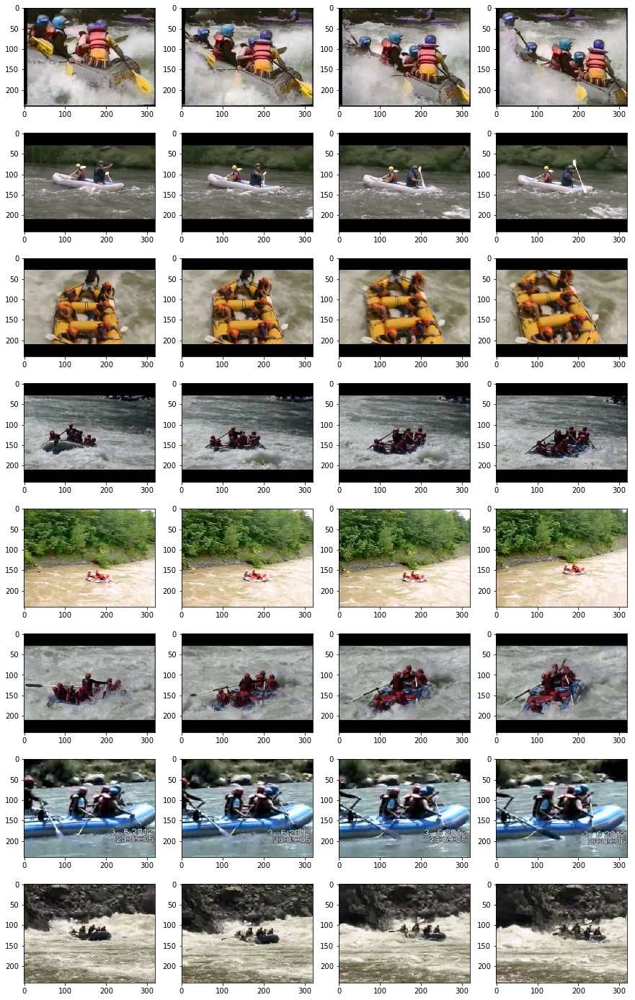

HORSERACE 71


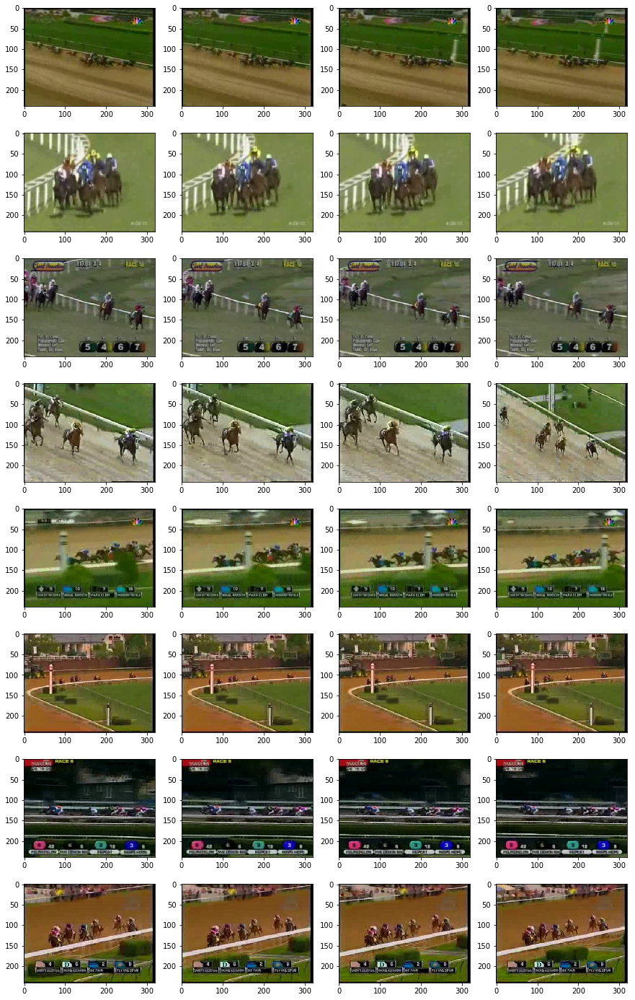

PIZZATOSSING 74


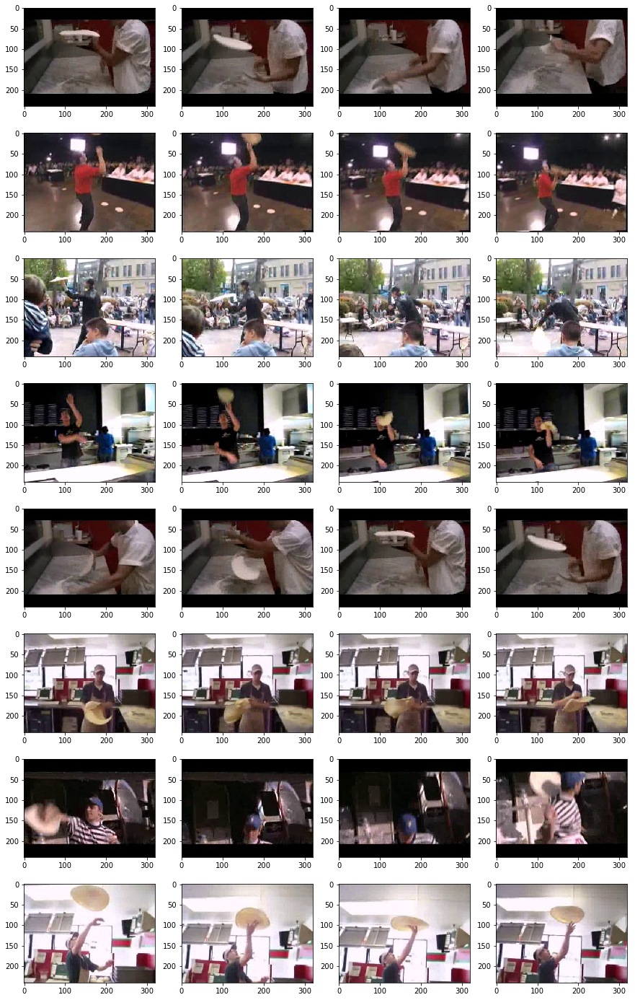

FENCING 79


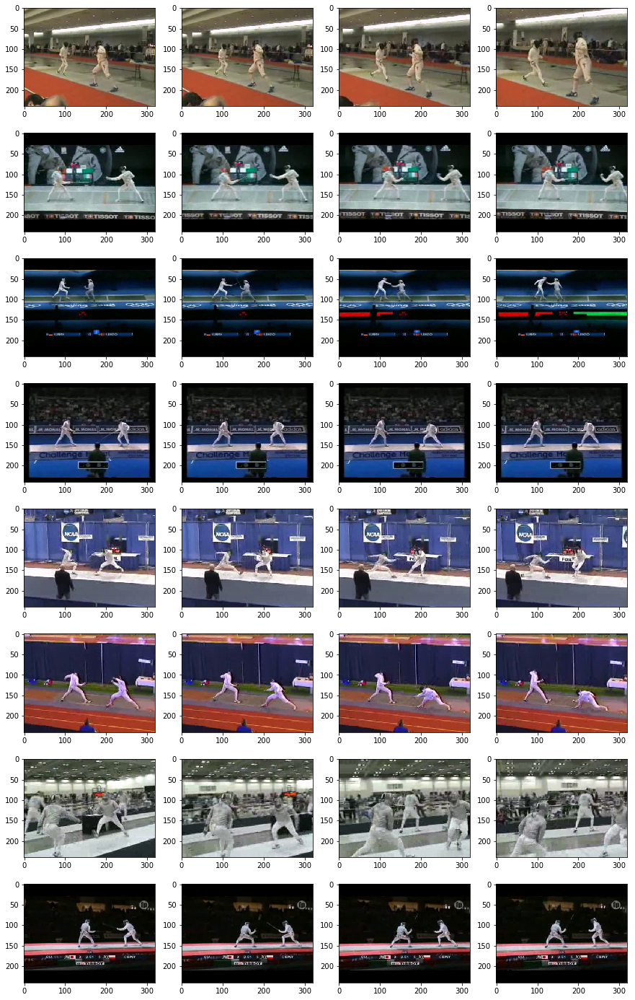

BILLIARDS 80


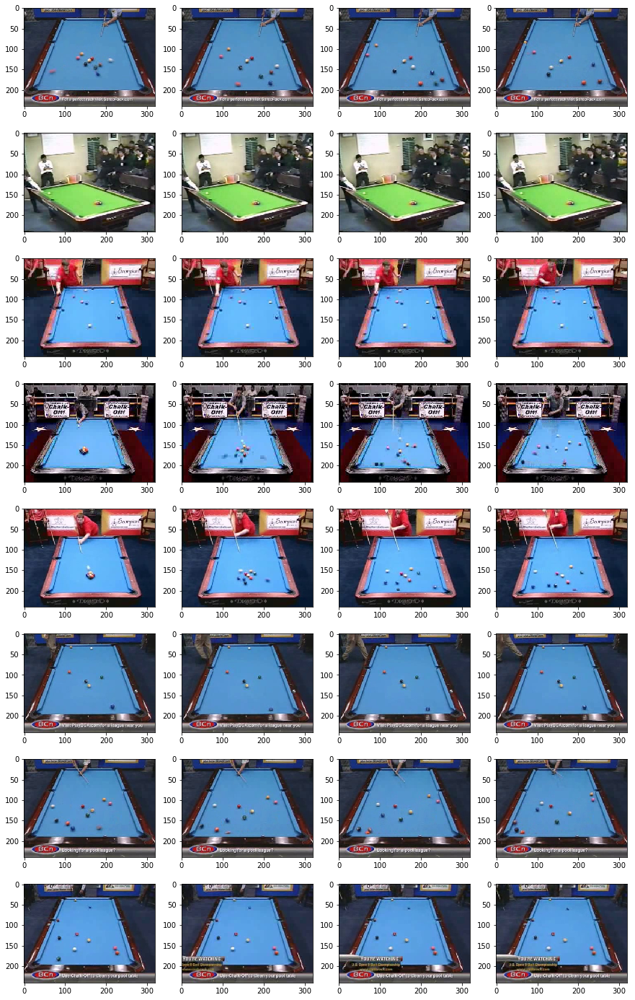

SHAVINGBEARD 83


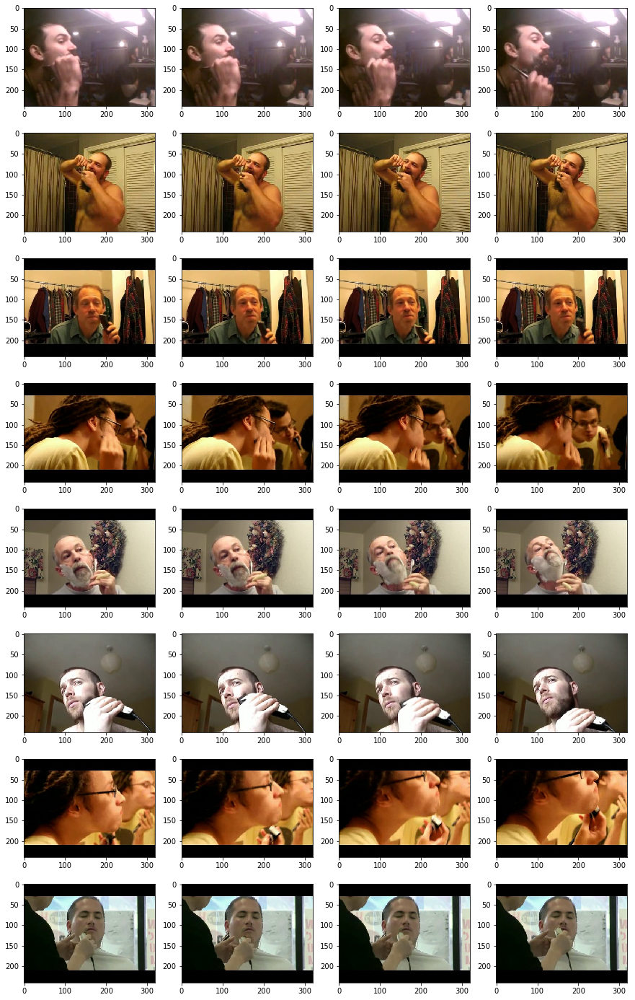

PLAYINGGUITAR 84


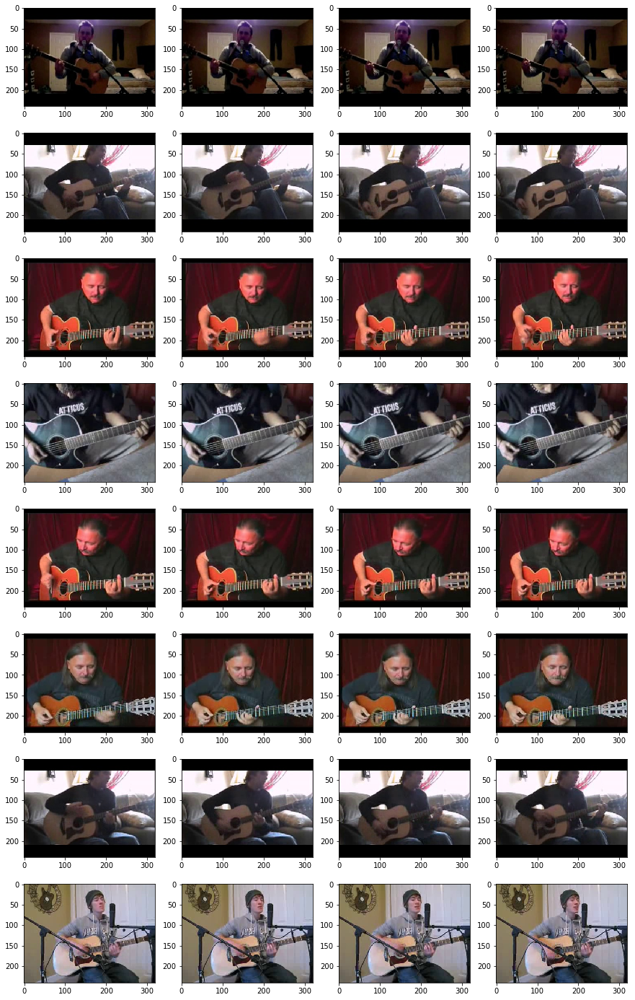

BREASTSTROKE 85


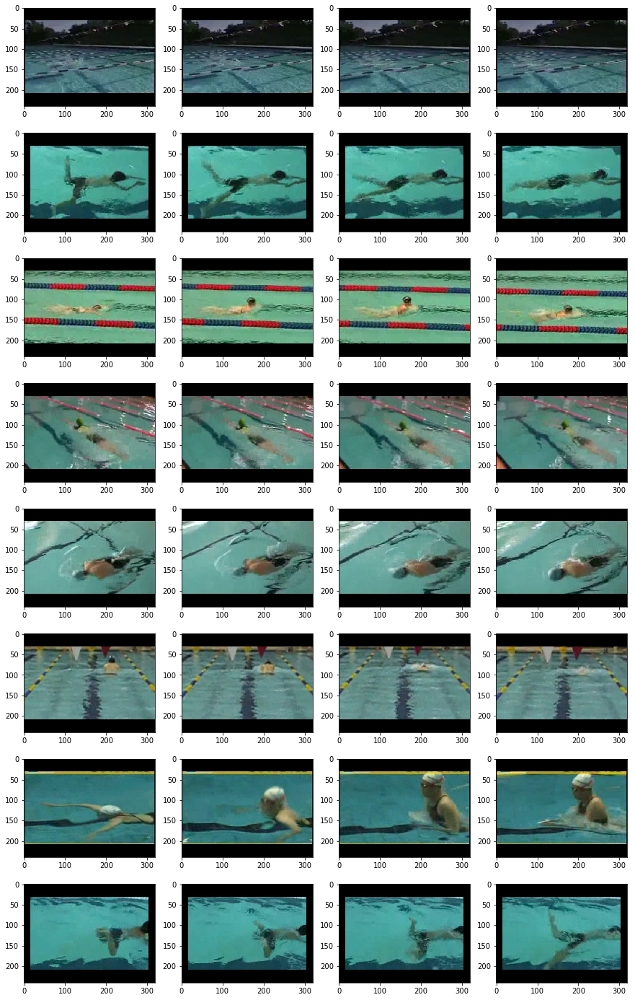

KNITTING 90


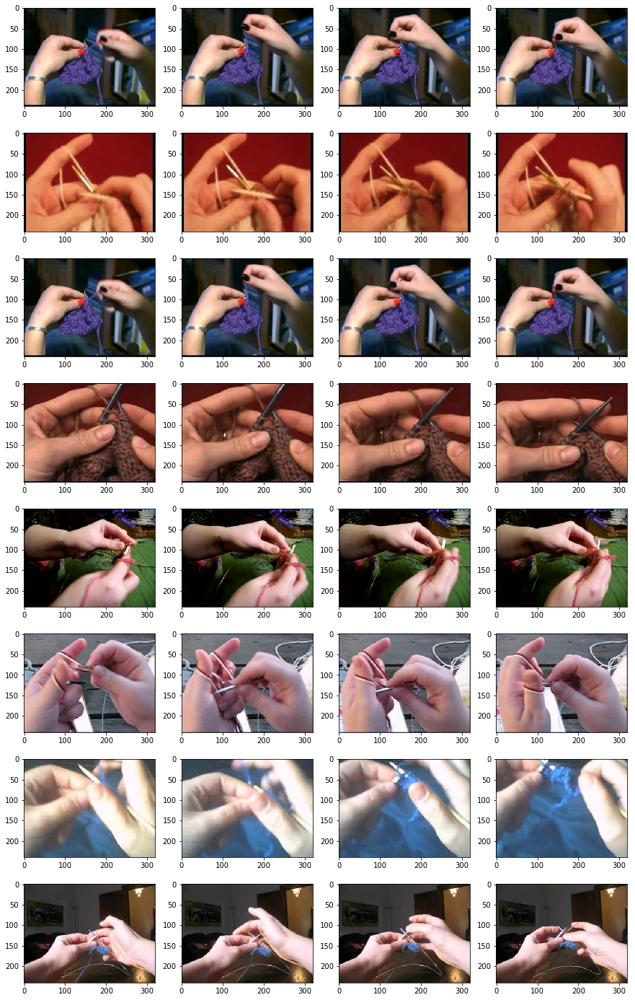

SURFING 98


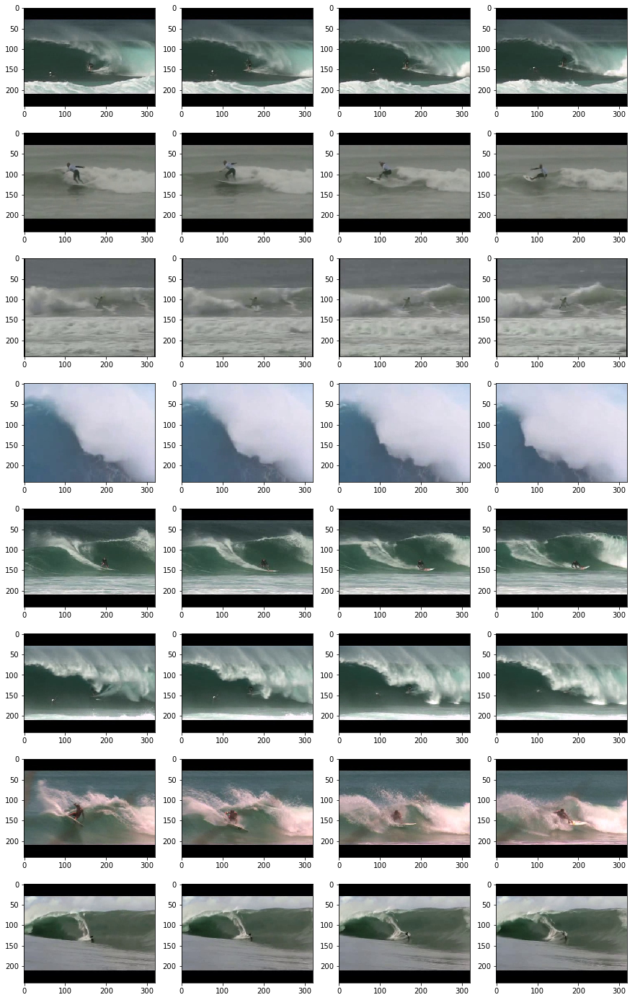

JUGGLINGBALLS 100


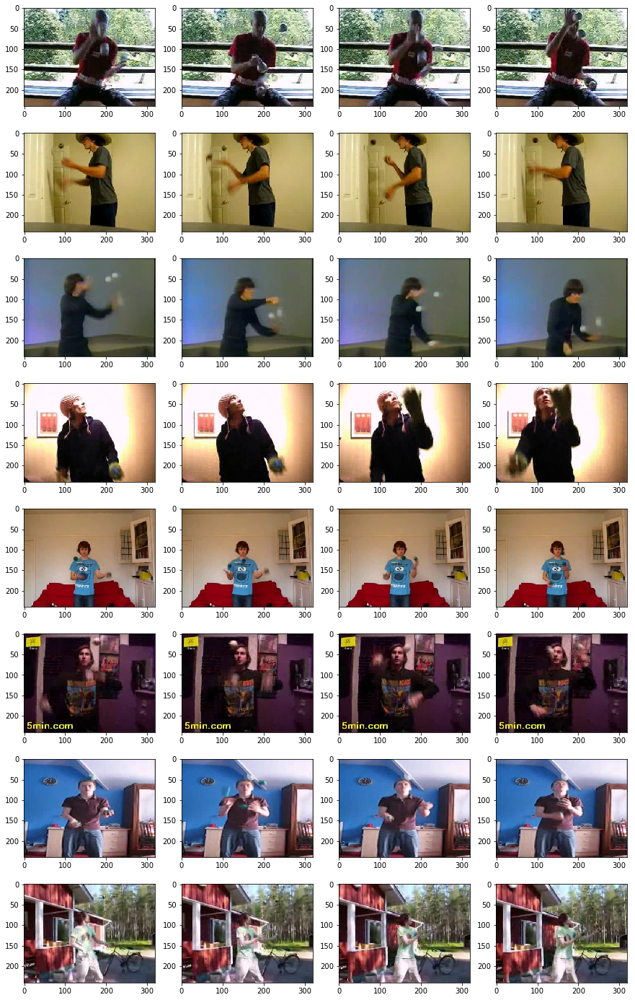

In [79]:
for index_cat,UCF_cat in enumerate(UCF_IMAGE):
    if UCF_cat.upper() in POTENTIAL_REMOVE_CLASSES:
        print UCF_cat.upper(), index_cat
        plt.figure()
        plt.subplots_adjust(wspace=1, hspace=1)
        plt.subplots(figsize=(15, 25))
        index = 1
        for frames in UCF_IMAGE[UCF_cat]:
            for frame in frames:
                suub_plt = plt.subplot(8, 4, index)
                plt.imshow(frame, interpolation='nearest', aspect='equal')
                index += 1
        plt.show()

In [19]:
REMOVE_CLASSES = [
    'MILITARYPARADE',
    'HAIRCUT',
    'TAICHI',
    'YOYO',
    'APPLYEYEMAKEUP',
    'BABYCRAWLING',
    'PLAYINGTABLA',
    'WRITINGONBOARD',
    'ROCKCLIMBINGINDOOR',
    'BANDMARCHING',
    'DRUMMING',
    'PLAYINGDAF',
    'BLOWINGCANDLES',
    'PLAYINGDHOL',
    'MOPPINGFLOOR',
    'PLAYINGPIANO',
    'TYPING',
    'SKIJET',
    'HEADMASSAGE',
    'PLAYINGSITAR',
    'HORSERACE',
    'SKYDIVING',
    'PLAYINGFLUTE',
    'APPLYLIPSTICK',
    'BRUSHINGTEETH',
    'SURFING',
    'JUGGLINGBALLS',
    'PLAYINGGUITAR',
    'SHAVINGBEARD',
    'BILLIARDS',
    'KNITTING',
    'FENCING',
    'BOXINGSPEEDBAG',
    'MIXING',
    'BLOWDRYER',
    'SALSASPIN',
    'CUTTINGINKITCHEN',
    'RAFTING',
    'HORSERACE',
]

In [20]:
TRAIN_UCF = []
TRAIN_HMDB = []
SMALL_TRAIN_UCF = []
for index, sample in enumerate(TRAIN_DATA['filename']):
    image_file_name = sample[0][0]
    if 'UCF101' in image_file_name:
        image_path = os.path.join(HOME_DIR, image_file_name)
        if len(glob.glob(image_path)):
            frames, crop = TRAIN_DATA['frame'][index], TRAIN_DATA['crop'][index]
            TRAIN_UCF.append((image_file_name, np.array(list(crop)), np.array(list(frames))))
    if 'HMDB51' in image_file_name:
        image_path = os.path.join(HOME_DIR, image_file_name)
        if len(glob.glob(image_path)):
            frames, crop = TRAIN_DATA['frame'][index], TRAIN_DATA['crop'][index]
            TRAIN_HMDB.append((image_file_name, np.array(list(crop)), np.array(list(frames))))
for sample in TRAIN_UCF:
    image_class = sample[0].split('/')[-1].split('_')[1].lower()
    if image_class.upper() not in REMOVE_CLASSES:
        SMALL_TRAIN_UCF.append(sample)
random.shuffle(SMALL_TRAIN_UCF)
random.shuffle(TRAIN_HMDB)
random.shuffle(SMALL_TRAIN_UCF)
random.shuffle(TRAIN_HMDB)
print len(SMALL_TRAIN_UCF), len(TRAIN_UCF), len(TRAIN_HMDB)

174707 274759 89955


In [21]:
with open(PICKLE_PATH, 'wb') as f:
    pickle.dump([SMALL_TRAIN_UCF, TRAIN_HMDB], f, pickle.HIGHEST_PROTOCOL)

In [22]:
with open(PICKLE_PATH, 'rb') as f:
    SMALL_TRAIN_UCF, TRAIN_HMDB = pickle.load(f)

In [23]:
train_samples_ucf, validation_samples_ucf = (70 * len(SMALL_TRAIN_UCF)) / 100, len(SMALL_TRAIN_UCF) / 10
test_samples_ucf = len(SMALL_TRAIN_UCF) - train_samples_ucf - validation_samples_ucf

train_samples_hmdb, validation_samples_hmdb = (70 * len(TRAIN_HMDB)) / 100, len(TRAIN_HMDB) / 10
test_samples_hmdb = len(TRAIN_HMDB) - train_samples_hmdb - validation_samples_hmdb

In [24]:
train_shape_ucf = (train_samples_ucf, 4, 120, 160, 3)
val_shape_ucf = (validation_samples_ucf, 4, 120, 160, 3)
test_shape_ucf = (test_samples_ucf, 4, 120, 160, 3)

In [25]:
hdf5_file = h5py.File(HDF5_PATH, mode='w')
hdf5_file.create_dataset("train_img", train_shape_ucf, np.float32)
hdf5_file.create_dataset("val_img", val_shape_ucf, np.float32)
hdf5_file.create_dataset("test_img", test_shape_ucf, np.float32)

<HDF5 dataset "test_img": shape (34943, 4, 120, 160, 3), type "<f4">

In [30]:
for i in range(train_samples_ucf):
    # print how many images are saved every 1000 images
    if i % 10000 == 0 and i > 1:
        print 'Train data: {}/{}'.format(i, train_samples_ucf)
    im_file_name, crop, frames = SMALL_TRAIN_UCF[i]
    im_file_paths = [os.path.join(HOME_DIR, im_file_name, 'Image' + str(frame) + '.jpg') for frame in frames]
    imgs = [cv2.imread(im_file_path) for im_file_path in im_file_paths]
    imgs = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in imgs]
    imgs = [cv2.resize(img, (160, 120), interpolation=cv2.INTER_CUBIC) for img in imgs]
    img = np.stack((imgs[0], imgs[1], imgs[2], imgs[3]), axis=0)
    hdf5_file["train_img"][i, ...] = img[None]

Train data: 10000/122294
Train data: 20000/122294
Train data: 30000/122294
Train data: 40000/122294
Train data: 50000/122294
Train data: 60000/122294
Train data: 70000/122294
Train data: 80000/122294
Train data: 90000/122294
Train data: 100000/122294
Train data: 110000/122294
Train data: 120000/122294


In [26]:
for index, sample in enumerate(SMALL_TRAIN_UCF[train_samples_ucf + validation_samples_ucf:]):
    # print how many images are saved every 1000 images
    if index % 4000 == 0 and index > 1:
        print 'Train data: {}/{}'.format(index, test_samples_ucf)
    im_file_name, crop, frames = sample
    im_file_paths = [os.path.join(HOME_DIR, im_file_name, 'Image' + str(frame) + '.jpg') for frame in frames]
    imgs = [cv2.imread(im_file_path) for im_file_path in im_file_paths]
    imgs = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in imgs]
    imgs = [cv2.resize(img, (160, 120), interpolation=cv2.INTER_CUBIC) for img in imgs]
    img = np.stack((imgs[0], imgs[1], imgs[2], imgs[3]), axis=0)
    hdf5_file["test_img"][index, ...] = img[None]

Train data: 4000/34943
Train data: 8000/34943
Train data: 12000/34943
Train data: 16000/34943
Train data: 20000/34943
Train data: 24000/34943
Train data: 28000/34943
Train data: 32000/34943


In [28]:
for index, sample in enumerate(SMALL_TRAIN_UCF[train_samples_ucf:train_samples_ucf + validation_samples_ucf]):
    # print how many images are saved every 1000 images
    if index % 5000 == 0 and index > 1:
        print 'Train data: {}/{}'.format(index, validation_samples_ucf)
    im_file_name, crop, frames = sample
    im_file_paths = [os.path.join(HOME_DIR, im_file_name, 'Image' + str(frame) + '.jpg') for frame in frames]
    imgs = [cv2.imread(im_file_path) for im_file_path in im_file_paths]
    imgs = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in imgs]
    imgs = [cv2.resize(img, (160, 120), interpolation=cv2.INTER_CUBIC) for img in imgs]
    img = np.stack((imgs[0], imgs[1], imgs[2], imgs[3]), axis=0)
    hdf5_file["val_img"][index, ...] = img[None]

Train data: 5000/17470
Train data: 10000/17470
Train data: 15000/17470


In [27]:
print len(SMALL_TRAIN_UCF[train_samples_ucf:train_samples_ucf + validation_samples_ucf])

17470
